# **Project Name**    -

# **$\color{maroon}{\text{Global Terrorism Analysis}}$**




In [2]:
from google.colab import files
from IPython.display import Image
uploaded = files.upload()

Saving Global-Terrorism-threat-analysis_Resource-center-image_landscape-01-1.png to Global-Terrorism-threat-analysis_Resource-center-image_landscape-01-1 (1).png


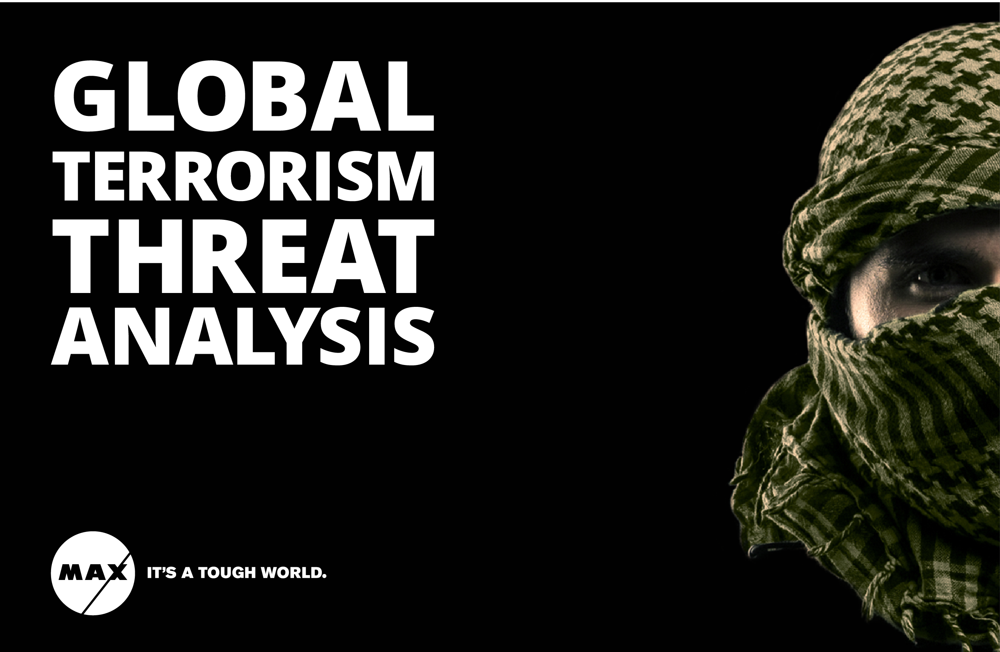

In [3]:
Image('Global-Terrorism-threat-analysis_Resource-center-image_landscape-01-1.png')

##### **Project Type**    - Exploratory Data Analysis
##### **Contribution**    - Individual
##### **Team Member 1**-  $\color{blue}{\text{Pratik Kanjilal}}$


# **Project Summary -**

**Data Preprocessing** :

1. Getting the dataset
2. Importing libraries
3. Importing datasets
4. Finding Missing Data
5. Handling Missing Data
6. Vizualizing feature importance.

**Exploratory data analysis(EDA) :**

1.Firstly Checked the no. of attacks took place in each year between 1970-2017.

2.Checked which terrorist agencies are the most active and successful ones.

3.Checked which country suffered the most casualities and damage caused by terrorist attacks.

4.Checked which is the weapon mostly used by the terrorist groups.

5.Checked locations or cities which have been attacked the most.

6.Checked the locations of the attacks took place in a single year **Geospacially** .

**For further Machine Learning approaches to be made :**
*   Checked the correlation between the columns using a heatmap.











# **GitHub Link -**

https://github.com/Pratik23-pk/global-terrotism-analysis

# **Problem Statement**


**Terrorist attacks pose a great threat to global security, and their analysis and prediction are imperative. Considering the high frequency of terrorist attacks and the inherent difficulty in finding related terrorist organizations,we performed an EDAto gain insights and find patterns on this dataset provided by National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland. This dataset has the attacks covered between year 1970-2017.**

# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [4]:
# Import Libraries
import pandas as pd
import missingno as msno
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings("ignore")

### Dataset Loading

In [5]:
#mounting the data set
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
# Load Dataset
path = '/content/drive/MyDrive/AlmaBetter Datascience/Datasets/Global Terrorism Data.csv'

df = pd.read_csv(path , encoding = "ISO-8859-1")

### Dataset First View

In [7]:
# Dataset First Look
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


### Dataset Rows & Columns count

In [8]:
# Dataset Rows & Columns count
df.shape

(181691, 135)

### Dataset Information

In [9]:
# Dataset Info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


#### Duplicate Values

In [10]:
# Dataset Duplicate Value Count
df.duplicated().sum()

0

In [11]:
print(f' We have {df.duplicated().sum()} duplicate values in dataset.')

 We have 0 duplicate values in dataset.


#### Missing Values/Null Values

In [12]:
# Missing Values/Null Values Count
df.isna().sum().sort_values(ascending=False)

gsubname3           181671
weapsubtype4_txt    181621
weapsubtype4        181621
weaptype4           181618
weaptype4_txt       181618
                     ...  
suicide                  0
success                  0
crit3                    0
property                 0
eventid                  0
Length: 135, dtype: int64

Text(0.5, 1.0, ' Visualising Missing Values')

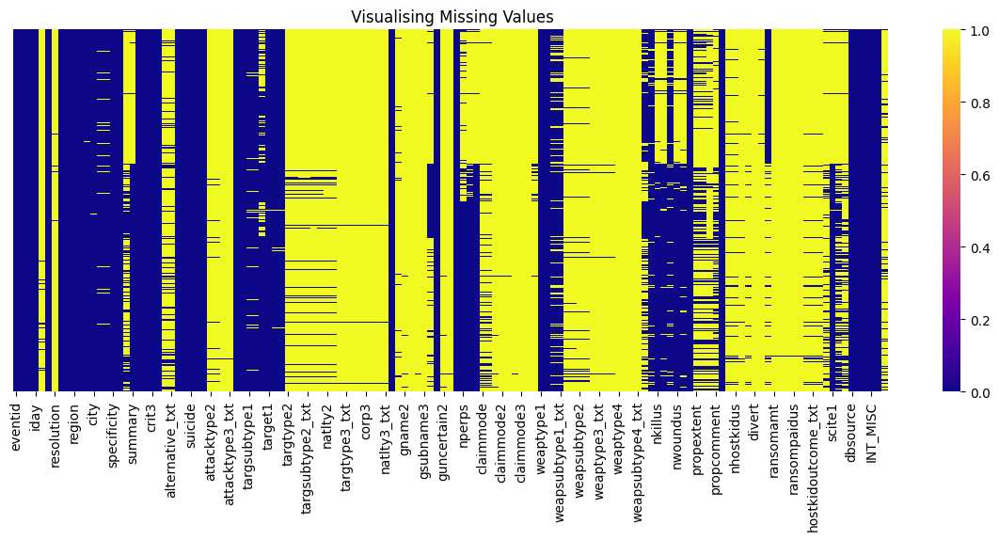

In [13]:
# Visualizing the missing values
plt.figure(figsize=(15,5))
sns.heatmap(df.isnull(),cmap='plasma',annot=False,yticklabels=False)
plt.title(" Visualising Missing Values")

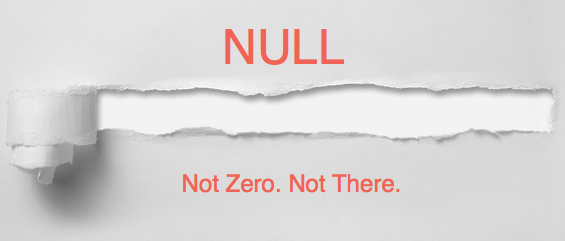

## ***2. Understanding Your Variables***

In [14]:
# Dataset Columns
df.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [15]:
# Dataset Describe
df.describe(include='all')

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
count,1.816910e+05,181691.000000,181691.000000,181691.000000,9239,181691.000000,2220,181691.000000,181691,181691.000000,...,28289,115500,76933,43516,181691,181691.000000,181691.000000,181691.000000,181691.000000,25038
unique,NaN,NaN,NaN,NaN,2244,NaN,1859,NaN,205,NaN,...,15429,83988,62263,36090,26,NaN,NaN,NaN,NaN,14306
top,NaN,NaN,NaN,NaN,"September 18-24, 2016",NaN,8/4/1998,NaN,Iraq,NaN,...,Casualty numbers for this incident conflict ac...,Committee on Government Operations United Stat...,"Christopher Hewitt, ""Political Violence and Te...","Christopher Hewitt, ""Political Violence and Te...",START Primary Collection,NaN,NaN,NaN,NaN,"201612010023, 201612010024, 201612010025, 2016..."
freq,NaN,NaN,NaN,NaN,101,NaN,18,NaN,24636,NaN,...,1607,205,134,139,78002,NaN,NaN,NaN,NaN,80
mean,2.002705e+11,2002.638997,6.467277,15.505644,NaN,0.045346,NaN,131.968501,NaN,7.160938,...,NaN,NaN,NaN,NaN,NaN,-4.543731,-4.464398,0.090010,-3.945952,NaN
std,1.325957e+09,13.259430,3.388303,8.814045,NaN,0.208063,NaN,112.414535,NaN,2.933408,...,NaN,NaN,NaN,NaN,NaN,4.543547,4.637152,0.568457,4.691325,NaN
min,1.970000e+11,1970.000000,0.000000,0.000000,NaN,0.000000,NaN,4.000000,NaN,1.000000,...,NaN,NaN,NaN,NaN,NaN,-9.000000,-9.000000,-9.000000,-9.000000,NaN
25%,1.991021e+11,1991.000000,4.000000,8.000000,NaN,0.000000,NaN,78.000000,NaN,5.000000,...,NaN,NaN,NaN,NaN,NaN,-9.000000,-9.000000,0.000000,-9.000000,NaN
50%,2.009022e+11,2009.000000,6.000000,15.000000,NaN,0.000000,NaN,98.000000,NaN,6.000000,...,NaN,NaN,NaN,NaN,NaN,-9.000000,-9.000000,0.000000,0.000000,NaN
75%,2.014081e+11,2014.000000,9.000000,23.000000,NaN,0.000000,NaN,160.000000,NaN,10.000000,...,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,NaN


### Check Unique Values for each variable.

In [16]:
# Check Unique Values for each variable.
variables_df = df.columns.to_list()

In [17]:

for i in variables_df:
  print('The Unique Values of', i, 'are:', df[i].unique())

The Unique Values of eventid are: [197000000001 197000000002 197001000001 ... 201712310030 201712310031
 201712310032]
The Unique Values of iyear are: [1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1986 1982
 1983 1984 1985 1987 1988 1989 1990 1991 1992 1994 1995 1996 1997 1998
 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012
 2013 2014 2015 2016 2017]
The Unique Values of imonth are: [ 7  0  1  2  3  4  5  6  8  9 10 11 12]
The Unique Values of iday are: [ 2  0  1  3  6  8  9 10 11 12 13 14 15 19 20 21 22 25 26 27 28 30 31  4
  7 16 17 18 23 24  5 29]
The Unique Values of approxdate are: [nan 'January 19-20, 1970' 'February 6-9, 1970' ... '2017-12-29 00:00:00'
 'December 25, 2017-January 5, 2018' '2017-12-31 00:00:00']
The Unique Values of extended are: [0 1]
The Unique Values of resolution are: [nan '3/8/1970' '3/15/1970' ... '3/23/2013' '12/9/2011' '12/27/2011']
The Unique Values of country are: [  58  130  160   78  101  217  218   98  499   65  

## 3. ***Data Wrangling***

### Data Wrangling Code

In [18]:
#creating list of numerical and categorical columns
numerical_columns=[]
for col in df.columns:
  if df[col].nunique()>5:
    numerical_columns.append(col)
categorical_columns=list(set(df.columns)-set(numerical_columns))

In [19]:
print(numerical_columns)

['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'resolution', 'country', 'country_txt', 'region', 'region_txt', 'provstate', 'city', 'latitude', 'longitude', 'location', 'summary', 'attacktype1', 'attacktype1_txt', 'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt', 'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt', 'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2', 'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2', 'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt', 'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3', 'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2', 'gname3', 'gsubname3', 'motive', 'nperps', 'nperpcap', 'claimmode', 'claimmode_txt', 'claimmode2', 'claimmode2_txt', 'claimmode3', 'claimmode3_txt', 'weaptype1', 'weaptype1_txt', 'weapsubtype1', 'weapsubtype1_txt', 'weaptype2', 'weaptype2_txt', 'weapsubtype2', 'weapsubtype2_txt', 'weaptype3', 'weaptype3_txt', 'weapsubtype3', 'weap

In [20]:
print(categorical_columns)

['weaptype4', 'suicide', 'claim2', 'guncertain3', 'claim3', 'crit2', 'propextent', 'doubtterr', 'propextent_txt', 'specificity', 'weaptype4_txt', 'alternative_txt', 'property', 'claimed', 'INT_IDEO', 'extended', 'guncertain2', 'guncertain1', 'vicinity', 'individual', 'compclaim', 'ransom', 'alternative', 'crit3', 'success', 'ishostkid', 'multiple', 'INT_MISC', 'crit1', 'INT_ANY', 'INT_LOG']


### What all manipulations have you done and insights you found?

We have created a separate columns for Numerical and Categorical Variables to work accordingly.It will help to understand the basic relationship between the features(defined as Categorical and Numerical) and the target variables.

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Chart - 1

**No of terrorist attacks per year** (Univariate)

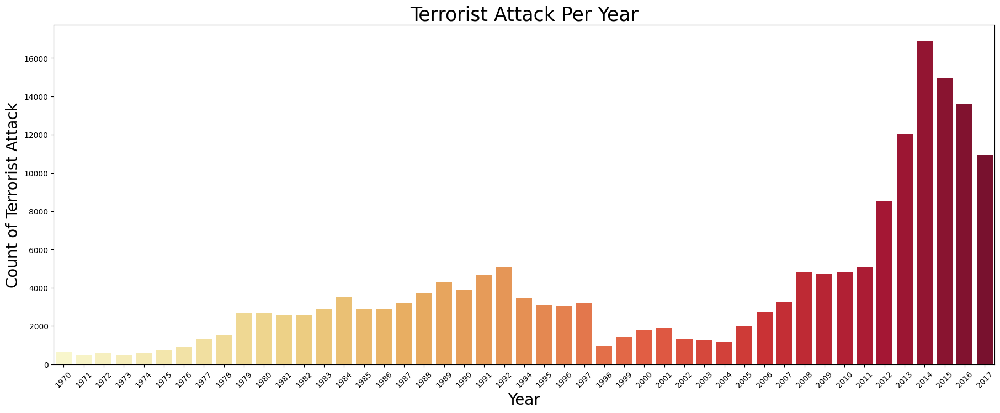

In [21]:
# Chart - 1 visualization code
# plotting no. of attacks per year
attack_per_year=df['iyear'].value_counts()
ax=plt.rcParams['figure.figsize'] = 22,8
ax=sns.countplot(x='iyear',palette='YlOrRd',data=df)
ax.set_xlabel('Year',fontsize=20)
plt.xticks(rotation = 45)
ax.set_ylabel('Count of Terrorist Attack',fontsize=20)
ax.set_title('Terrorist Attack Per Year',fontsize=25);

##### 1. Why did you pick the specific chart?

To check the distribution of the attacks across the years and to find out the year in which maximum no. of attacks took place.

##### 2. What is/are the insight(s) found from the chart?

* The highest number of attack took place in year **2014**
* The no. of attacks on an average are gradually increasing year on year




##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.It will help to gain insight to help creating a positive business impact in terms of Defence Analysis and Counter-terrorism analysis.

#### Chart - 2

**Terrorist Activities by Region in each Year**  (Bivariate)

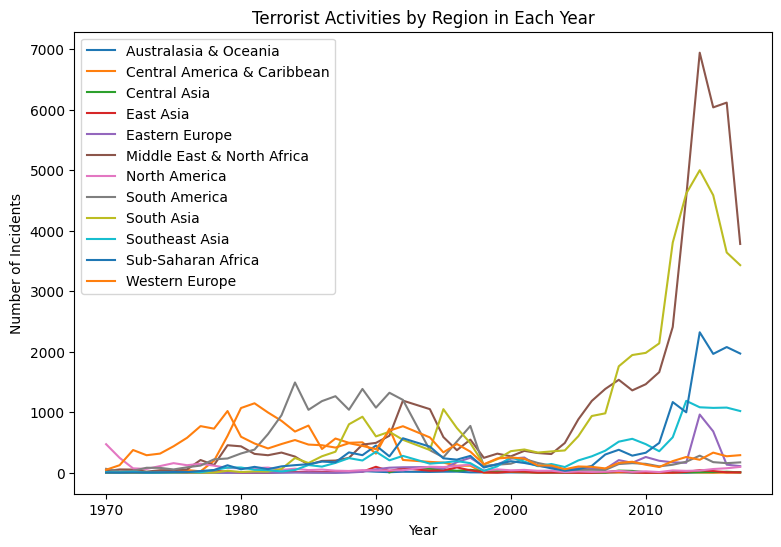

In [22]:
# Chart - 2 visualization code
grouped = df.groupby(['region_txt', 'iyear'])['eventid'].count().reset_index()

fig, ax = plt.subplots(figsize=(9,6))
for region in grouped['region_txt'].unique():
    region_data = grouped[grouped['region_txt'] == region]
    ax.plot(region_data['iyear'], region_data['eventid'], label=region)

ax.set_title('Terrorist Activities by Region in Each Year')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Incidents')
ax.legend()
plt.show()

##### 1. Why did you pick the specific chart?

To check the geographical areas affected the most and in which year.

##### 2. What is/are the insight(s) found from the chart?

*   The terrorist activities surged in **Western europe** from mid of  year 1970 to mid of year 1990
*   And the terrorist activities were more active in **Central America** and **Carribean** from year 1970 to year 2000 and its gradually getting less

*  The terrorist activities which are not decreasing from year 1970 till now is **Middle East** and **North Africa** its rather getting increased


##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.It will help to gain insight to help creating a positive business impact.

#### Chart - 3

**Top 30 countries been attacked the most** (Univariate)

Text(0.5, 1.0, 'Top 30 Country via Numbers of Attacks')

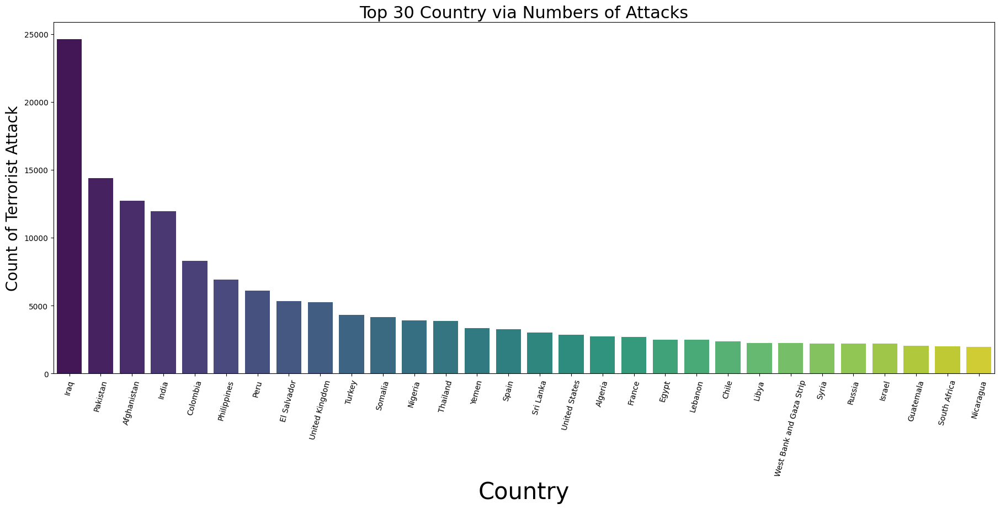

In [23]:
# Chart - 3 visualization code
ax=plt.rcParams['figure.figsize'] = 22,8.27
ax=sns.countplot(x='country_txt',palette = 'viridis' ,data=df,order = df['country_txt'].value_counts().index[:30])
ax.set_xlabel('Country',fontsize=30)
plt.xticks(rotation = 75)
ax.set_ylabel('Count of Terrorist Attack',fontsize=20)
ax.set_title('Top 30 Country via Numbers of Attacks',fontsize=22)

##### 1. Why did you pick the specific chart?

To check the country suffered most and its successors.

##### 2. What is/are the insight(s) found from the chart?

**IRAQ** is on the top list of been attacked most

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.It will help to gain insight to help creating a positive business impact.

#### Chart - 4

**The weapons mostly used by the agencies in attacks** (Univariate)

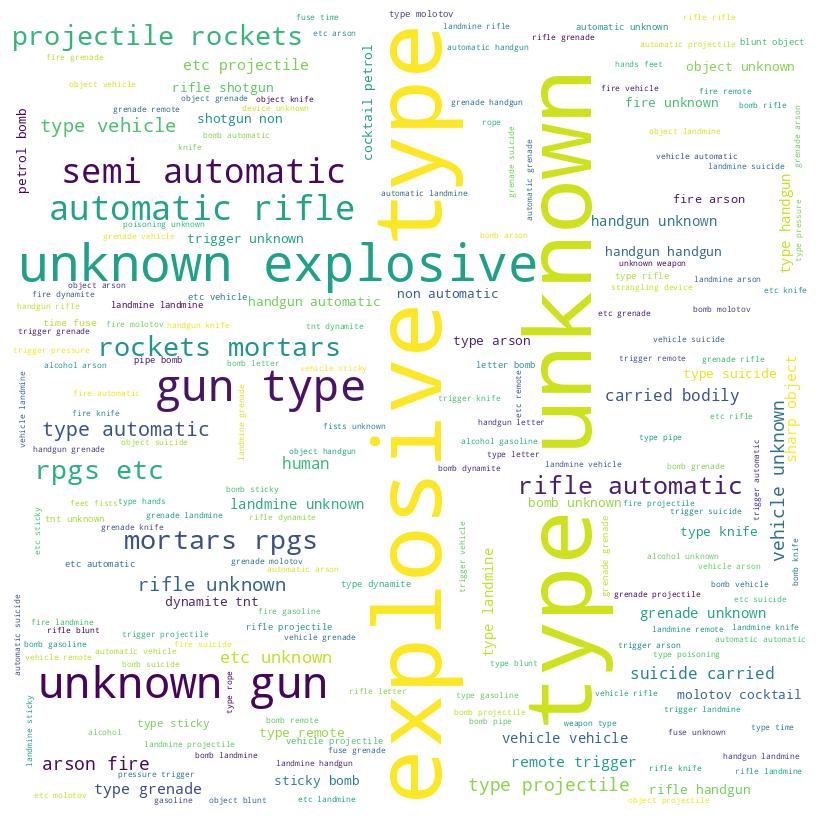

In [24]:
# Chart - 4 visualization code
from wordcloud import WordCloud


cities = df['weapsubtype1_txt'].dropna().astype(str).str.lower().str.cat(sep=' ')#str.cat(sep=' ') method to concatenate all the city names with a space separator.


wordcloud = WordCloud(width=800, height=800, background_color='white').generate(cities)
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

##### 1. Why did you pick the specific chart?

To find out the most frequently used weapons by the terrorists.

##### 2. What is/are the insight(s) found from the chart?

* **Explosives** are the most frequently used weapons by the terrorists.


##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.It will help to gain insight to help creating a positive business impact.

#### Chart - 5

**Types of attacks** (Univariate)

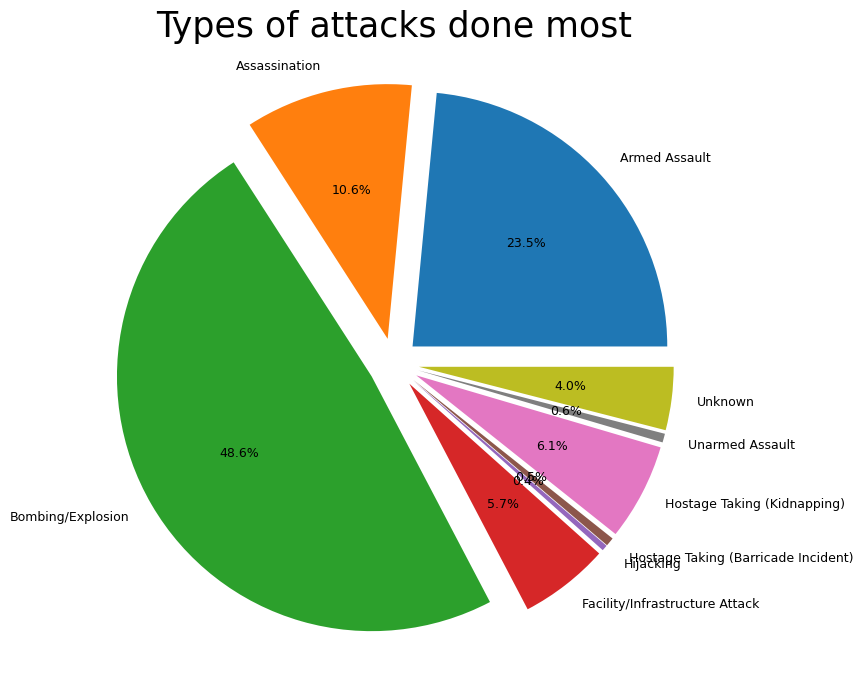

In [25]:
# Chart - 5 visualization code
df_grouped = df.groupby('attacktype1_txt').size().reset_index(name='counts')
explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1)
plt.pie(df_grouped['counts'], labels=df_grouped['attacktype1_txt'], autopct='%1.1f%%',explode=explode, textprops={'fontsize': 9})
plt.title("Types of attacks done most",fontsize=25 )
plt.show()

##### 1. Why did you pick the specific chart?

To check how the attacks are shared among the different types of attacks performed by the terrorists .

##### 2. What is/are the insight(s) found from the chart?

* Here we have analysed that the attacks were mostly performed in the form of **Bombing/Explosion**. i.e **48.6%** among all other types.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.It will help to gain insight to help creating a **hypothesis** of their attacks depending upon **some other important factors**.

#### Chart - 6

**The deaths, injuries and loss of properties caused due to the attacks** (Multivariate)

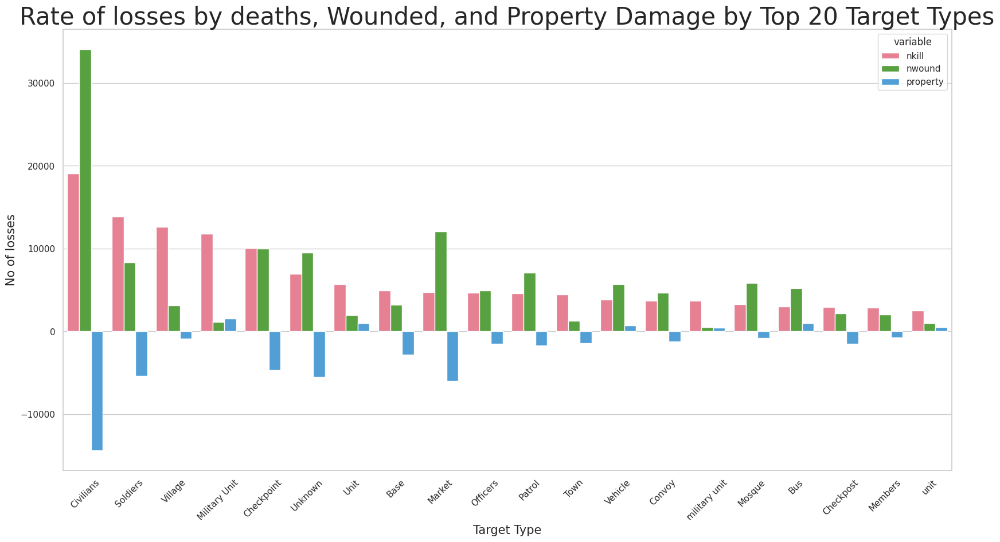

In [26]:
# Chart - 6 visualization code
sns.set_theme(style='whitegrid')

df_top_targets = df.groupby('target1')[['nkill', 'nwound', 'property']].sum().sort_values('nkill', ascending=False).head(20).reset_index()

plt.figure(figsize=(20, 10))
ax = sns.barplot(x='target1', y='value', hue='variable', data=pd.melt(df_top_targets, id_vars='target1'),palette='husl')
ax.set_title('Rate of losses by deaths, Wounded, and Property Damage by Top 20 Target Types',fontsize=30)
ax.set_xlabel('Target Type',fontsize=15)
ax.set_ylabel('No of losses',fontsize=15)

ax.tick_params(axis='x', rotation=45)

plt.show()

##### 1. Why did you pick the specific chart?

To find out the specific group(s) of people who have suffered the most due to the attacks and their physical and financial damages across the world.

##### 2. What is/are the insight(s) found from the chart?

* The Analysis indicates that the **rate of wounded** and **death** of the **civilians** are more in quantity compared the other different groups of people.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.it will help us to create a postitive business impact by prioritizing the safety and security of the **Civillians**.

#### Chart - 7

**Top 30 Countries Facing Highest Number of Casualties and Injuries combined in total due to Terrorist Attacks** (Univariate)

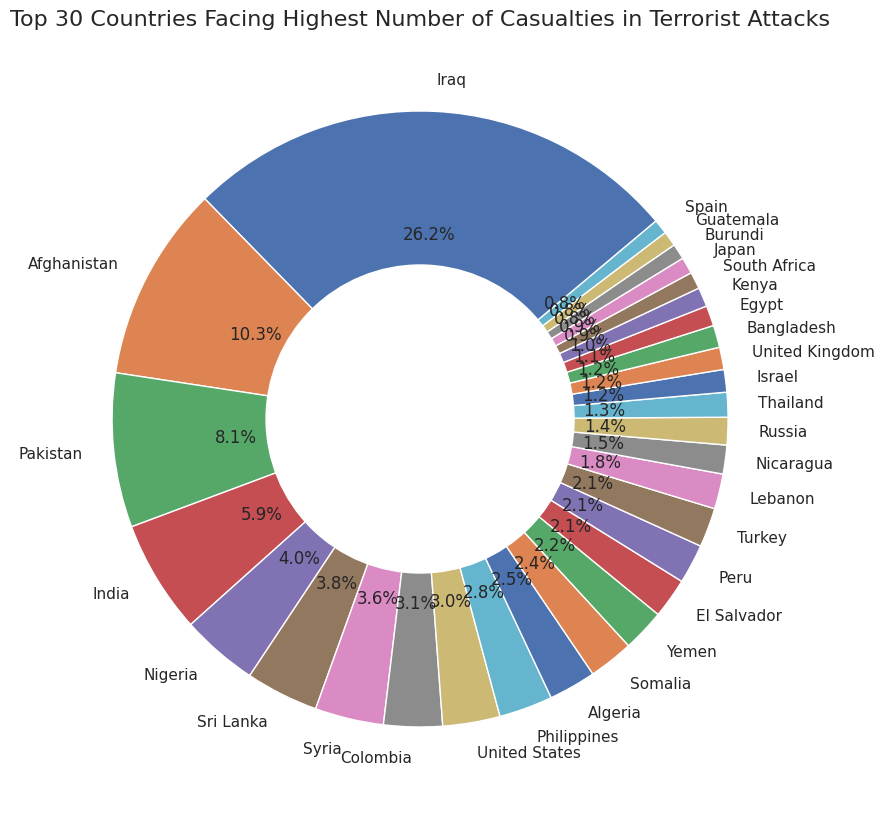

In [27]:
# Chart - 7 visualization code

df_casualties = df.groupby('country_txt')[['nkill', 'nwound']].sum().reset_index()
df_casualties['total_casualties'] = df_casualties['nkill'] + df_casualties['nwound']
df_top_casualties = df_casualties.sort_values('total_casualties', ascending=False).head(30)
plt.figure(figsize=(10, 10))
plt.pie(df_top_casualties['total_casualties'], labels=df_top_casualties['country_txt'], autopct='%1.1f%%', startangle=40)
centre_circle = plt.Circle((0, 0), 0.50, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title('Top 30 Countries Facing Highest Number of Casualties in Terrorist Attacks', fontsize=16)
plt.show()


##### 1. Why did you pick the specific chart?

To check how secured and safe the citizens of different Countries are in terms Terrorist Activities.

##### 2. What is/are the insight(s) found from the chart?

* The country which has faced hightest no of casulaties is **Iraq** (**26.2**%) ,
* At 2nd place its **Afghanistan**  (**10.2**%) and
* **Pakistan** (**8.1**%) is in 3rd place.

These are the **top 3 countries of whom the Citizens have faced the highest no. of deaths and injuries** throughout the time period.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.it will help us to create a postitive business impact by prioritizing the safety and security of the **Civillians** of the above said Countries.

#### Chart - 8

**Countries which have faced the highest number of GunsAttack** (Univariate)

In [28]:
# Chart - 8 visualization code

df_gunsAttack = df.query("gname == 'Unknown'").groupby(["country_txt"])["nkill"].count()
df_gunsAttack

country_txt
Afghanistan            4735
Albania                  75
Algeria                1172
Angola                   61
Antigua and Barbuda       0
                       ... 
Yemen                   989
Yugoslavia              122
Zaire                    33
Zambia                   29
Zimbabwe                 53
Name: nkill, Length: 192, dtype: int64

In [29]:

pd.options.plotting.backend = "plotly"
fig = df_gunsAttack.plot()
fig.show()

##### 1. Why did you pick the specific chart?

To check the terrorist activities which are in the form of various types of **Guns Assault** directly to the **civillians** of different countries with their amount of **Severity** across the years

##### 2. What is/are the insight(s) found from the chart?

**Top 5 Countries in the list with their numbers are:**
* **Iraq** - 18,287
* **Pakistan** - 10,691
* **Afghanistan** - 4735
* **India** - 4191
* **Thailand** - 3002

**Iraq** is the country, faced the highest no. of casualities caused by "**Guns Attack"**

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.it will help us to create a postitive business impact by prioritizing the safety and security of the **Civillians** of the above said Countries.

#### Chart - 9 - Geospacial Visualization

**Visualization of cities grouped by countries and further grouped by regions** which have been attacked **in the year with the maximum no. of attacks = 2014**
   (Multivariate)

In [30]:
# Chart - 9 visualization code

import folium
from folium.plugins import MarkerCluster
filterYear = df['iyear'] == 2014
filterData = df[filterYear] # filter data
# filterData.info()

reqFilterData = filterData.loc[:,'city':'longitude'] #We are getting the required fields
reqFilterData = reqFilterData.dropna() # drop NaN values in latitude and longitude
reqFilterDataList = reqFilterData.values.tolist()
# reqFilterDataList

map = folium.Map(location = [0, 30], tiles='CartoDB positron', zoom_start=2)
# clustered marker
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(reqFilterDataList)):
    folium.Marker(location=[reqFilterDataList[point][1],reqFilterDataList[point][2]],
                  popup = reqFilterDataList[point][0]).add_to(markerCluster)
map

##### 1. Why did you pick the specific chart?

To check visualize location wise Global Terrorist Attacks  for the year "**2014**".

##### 2. What is/are the insight(s) found from the chart?

* In the **Year in which most no. of attacks took place** we can see that, **Middle East** and **South East Asia** are the most attacked regions.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Yes.It will help to gain insight to help creating a **hypothesis** of their attacks depending upon **some other important factors**.

#### Chart - 10 - Correlation Heatmap

<Axes: >

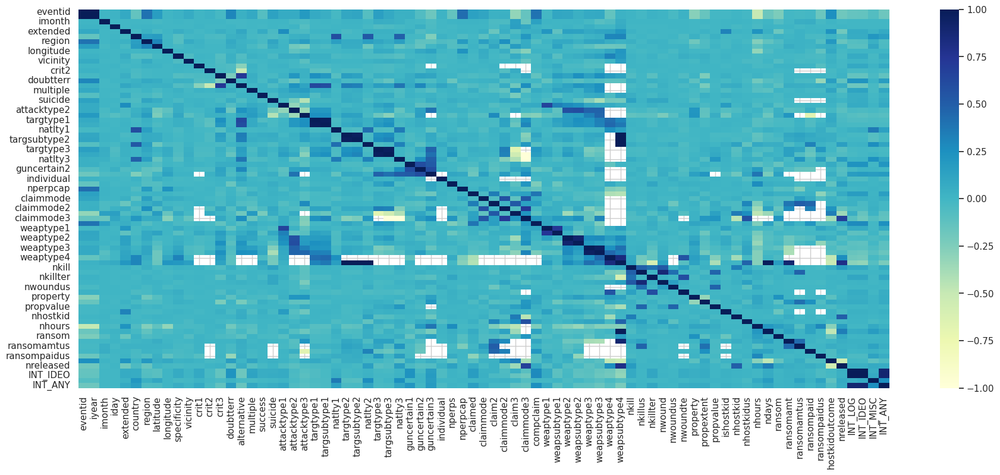

In [31]:
# Heatmap visualization code
sns.heatmap(df.corr(),cmap="YlGnBu")

##### 1. Why did you pick the specific chart?

Pair plot is used to understand the best set of features to explain a relationship between two variables or to form the most separated clusters. It also helps to form some simple classification models by drawing some simple lines or make linear separation in our data-set.

Thus, I used pair plot to analyse the patterns of data and realationship between the features. It's exactly same as the correlation map but here you will get the graphical representation.

##### 2. What is/are the insight(s) found from the chart?

* From the above chart I got to know, there are less linear relationship between variables and data poiunts aren't linearly separable

## **5. Solution to Business Objective**

#### What do you suggest the client to achieve Business Objective ?
Explain Briefly.

Some of my key findings were:

* The terrorism activities and the attacks were done mostly in the Western regions like **Europe, America** etc. But across the years the incidents started to shift from there to the **Middle East and South Asia** regions.

* Muslim majority countries  **Iraq, Afghanistan, Pakistan** have been damaged the most in terms of human casualities as well as property damage.

Therfore **Security** of the **Citizens** of **these countries** is a matter to be highly concerned about.

# **Conclusion**

From EDA we can observe,

* Country with the most attacks:   **Iraq**

* City with the most attacks:   **Baghdad**

* Region with the most attacks:   **Middle East** & **North Africa**

* Year with the most attacks:   **2014**


* Group with the most attacks:   **Taliban**

* Most Attack Types:   **Bombing**/**Explosion**

* The terrorist attacks  took place most oftenly is in **Iraq** and the success rate is also high in **Iraq** which indicates very low security for its citizens.

* On 2nd place is **Pakistan** And on 3rd is **Afghanistan**


### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***